In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import scvelo as scv
import scanpy as sc
import scipy as scp
import pickle
import anndata
import matplotlib.pyplot as plt
sns.set_style("white")

In [3]:
scv.__version__
scv.settings.verbosity = 3

In [2]:
pd.__version__

'1.4.2'

### Adapted from https://github.com/BUStools/getting_started/blob/master/velocity_tutorial.ipynb

## Import matrices

In [3]:
spliced = "../../files/200630Van/brq_merged_intron/spliced/"
unspliced = "../../files/200630Van/brq_merged_intron//unspliced/"

s = sc.read_mtx(spliced + "s.mtx")
u = sc.read_mtx(unspliced + "u.mtx")

s_bcs = pd.read_csv(spliced + "s.barcodes.txt", header=None)
u_bcs = pd.read_csv(unspliced + "u.barcodes.txt", header=None)

s_genes = pd.read_csv(spliced + "s.genes.txt", header=None)
u_genes = pd.read_csv(unspliced + "u.genes.txt", header=None)

s.obs.index = s_bcs[0].values
u.obs.index = u_bcs[0].values

s.var.index = s_genes[0].values
u.var.index = u_genes[0].values

In [4]:
s_bcs.columns = ["bcs"]
u_bcs.columns = ["bcs"]

In [5]:
s_bcs.index = s_bcs["bcs"]
u_bcs.index = u_bcs["bcs"]

In [6]:
genes = s_genes
genes.columns=["gid"]

In [7]:
s = scp.sparse.vstack([s.X])
u = scp.sparse.vstack([u.X])
sadata = anndata.AnnData(X=s, obs=s_bcs, var=genes)
uadata = anndata.AnnData(X=u, obs=u_bcs, var=genes)

In [8]:
sadata = sadata[sadata.obs.index.isin(uadata.obs.index),:]
uadata = uadata[uadata.obs.index.isin(sadata.obs.index),:]

In [9]:
print(sadata)
print(uadata)

View of AnnData object with n_obs × n_vars = 1893985 × 54838
    obs: 'bcs'
    var: 'gid'
View of AnnData object with n_obs × n_vars = 1893985 × 54838
    obs: 'bcs'
    var: 'gid'


In [10]:
# from earlier analyses with cells that have sufficient reads
barcodes_pass_df = pd.read_csv("demultiplex_annotation.csv", header=None)
barcodes_pass = list(barcodes_pass_df[0])
barcodes_pass[:5]

['AAACCCAAGCGGGTTA',
 'AAACCCAAGCGGTAAC',
 'AAACCCAAGGGTCACA',
 'AAACCCAAGGTCGTAG',
 'AAACCCAAGTTTCGAC']

In [11]:
barcodes_pass_df.shape

(15608, 2)

In [12]:
sadata_pass = sadata[sadata.obs.bcs.isin(barcodes_pass)]
uadata_pass = uadata[uadata.obs.bcs.isin(barcodes_pass)]

In [13]:
print(sadata_pass)
print(uadata_pass)

View of AnnData object with n_obs × n_vars = 15582 × 54838
    obs: 'bcs'
    var: 'gid'
View of AnnData object with n_obs × n_vars = 15582 × 54838
    obs: 'bcs'
    var: 'gid'


In [14]:
# get rid of "fake" droplets
cells_with_reads = (np.sum(sadata_pass.X, axis=1) > 5000).flatten().tolist()[0]
sadata_pass2 = sadata_pass[cells_with_reads]
uadata_pass2 = uadata_pass[cells_with_reads]
print(sadata_pass2)
print(uadata_pass2)

View of AnnData object with n_obs × n_vars = 12669 × 54838
    obs: 'bcs'
    var: 'gid'
View of AnnData object with n_obs × n_vars = 12669 × 54838
    obs: 'bcs'
    var: 'gid'


In [15]:
t2g = pd.read_csv("/home/briando/data/software/kallisto_indices/mouse_intron_index/cDNA_introns.t2g.txt", 
                  header=None, sep="\t", names=["tid", "gid", "gene"])
t2g = t2g.drop_duplicates(["gid", "gene"])
t2g = t2g.set_index("gid")

In [16]:
adata = sadata_pass2.copy()

adata.layers["spliced"] = sadata_pass2.X
adata.layers["unspliced"] = uadata_pass2.X
adata.layers["ambiguous"] = scp.sparse.csr_matrix(np.zeros(adata.X.shape))

adata.obs = sadata_pass2.obs
adata.var.index = sadata_pass2.var.gid

adata.obs["CellID"] = adata.obs.index
adata.var["Gene"] = adata.var.index.map(t2g["gene"])
adata.var["Accession"] = adata.var.index
adata.var = adata.var.set_index("Gene")

Trying to set attribute `.obs` of view, copying.


In [17]:
sadata_pass2._X

<12669x54838 sparse matrix of type '<class 'numpy.float32'>'
	with 46260990 stored elements in Compressed Sparse Row format>

In [18]:
scv.pp.show_proportions(adata)
print(adata)

Abundance of ['spliced', 'unspliced']: [0.66 0.34]
AnnData object with n_obs × n_vars = 12669 × 54838
    obs: 'bcs'
    var: 'gid', 'Accession'
    layers: 'spliced', 'unspliced', 'ambiguous'


In [19]:
sadata_pass

View of AnnData object with n_obs × n_vars = 15582 × 54838
    obs: 'bcs'
    var: 'gid'

## scVelo
https://scvelo.readthedocs.io/getting_started.html

In [21]:
scv.pp.filter_and_normalize(adata, min_shared_counts=20)  # do this before subsetting, because it needs an _X attribute

Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


Filtered out 43351 genes that are detected 20 counts (shared).
Normalized count data: X, spliced, unspliced.
Logarithmized X.


In [22]:
barcodes_pass_df = barcodes_pass_df.drop_duplicates()
adata.obs["bc"] = [barcodes_pass_df[barcodes_pass_df[0] == x][1].item() for x in adata.obs.bcs]

In [9]:
brq = adata[adata.obs['bc'].isin(["Bar5", "Bar4", "Bar3", "Bar2", "Bar1", "Bar10"])]
e2w = adata[adata.obs['bc'].isin(["Bar9", "Bar8", "Bar7", "Bar6", "Bar5", "Bar10"])]

NameError: name 'adata' is not defined

In [ ]:
# import pickle
# pickle.dump(brq, open("200907_brq_velocity.pkl", 'wb'))
# pickle.dump(e2w, open("200907_e2w_velocity.pkl", 'wb'))

In [2]:
# if calculated before
brq = pickle.load(open("200907_brq_velocity.pkl", 'rb'))
e2w = pickle.load(open("200907_e2w_velocity.pkl", 'rb'))

In [5]:
print(brq.layers["spliced"].sum())
print(brq.layers["unspliced"].sum())

77278640.0
41569490.0


In [6]:
def replace_barcode(bc):
    if bc == "Bar6": return("E2 w/d 48h")
    if bc == "Bar7": return("E2 w/d 24h")
    if bc == "Bar8": return("E2 w/d 12h")
    if bc == "Bar9": return("E2 w/d 6h")
    if bc == "Bar5" or bc == "Bar10": return("E2 w/d 0h")
e2w.obs["bc"] = [replace_barcode(x) for x in e2w.obs["bc"]]

In [7]:
def replace_barcode(bc):
    if bc == "Bar1": return("BRQ 48h")
    if bc == "Bar2": return("BRQ 24h")
    if bc == "Bar3": return("BRQ 12h")
    if bc == "Bar4": return("BRQ 6h")
    if bc == "Bar5" or bc == "Bar10": return("BRQ 0h")
brq.obs["bc"] = [replace_barcode(x) for x in brq.obs["bc"]]

In [8]:
scv.settings.set_figure_params('scvelo')

In [9]:
# from seurat
sgenes = ['Mcm5', 'Pcna', 'Tyms', 'Fen1', 'Mcm2', 'Mcm4', 'Rrm1', 
          'Ung', 'Mcm6', 'Cdca7', 'Dtl', 'Prim1', 'Uhrf1', 
          'Hells', 'Rfc2', 'Rpa2', 'Nasp', 'Rad51ap1', 
          'Gmnn', 'Wdr76', 'Slbp', 'Ccne2', 'Ubr7', 'Pold3', 'Msh2', 
          'Atad2', 'Rad51', 'Rrm2', 'Cdc45', 'Cdc6', 'Exo1', 'Tipin', 
          'Dscc1', 'Blm', 'Casp8ap2', 'Usp1', 'Clspn', 'Pola1', 'Chaf1b', 
          'Brip1', 'E2f8']
g2mgenes = ['Hmgb2', 'Cdk1', 'Nusap1', 'Ube2c', 'Birc5', 'Tpx2', 'Top2a', 
            'Ndc80', 'Cks2', 'Nuf2', 'Cks1b', 'Mki67', 'Tmpo', 'Cenpf', 
            'Tacc3', 'Smc4', 'Ccnb2', 'Ckap2l', 'Ckap2', 'Aurkb', 
            'Bub1', 'Kif11', 'Anp32e', 'Tubb4b', 'Gtse1', 'Kif20b', 'Hjurp', 
            'Cdca3', 'Cdc20', 'Ttk', 'Cdc25c', 'Kif2c', 'Rangap1', 
            'Ncapd2', 'Dlgap5', 'Cdca2', 'Cdca8', 'Ect2', 'Kif23', 'Hmmr', 
            'Aurka', 'Psrc1', 'Anln', 'Lbr', 'Ckap5', 'Cenpe', 'Ctcf', 'Nek2', 
            'G2e3', 'Gas2l3', 'Cbx5', 'Cenpa']

## BRQ -- normal UMAP using all highly variable genes

In [10]:
brq = brq[~brq.obs.bc.isin(["BRQ 6h"])]  # getting rid of BRQ 6h because its G1 cells are a little weird

computing neighbors
    finished (0:00:01) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)


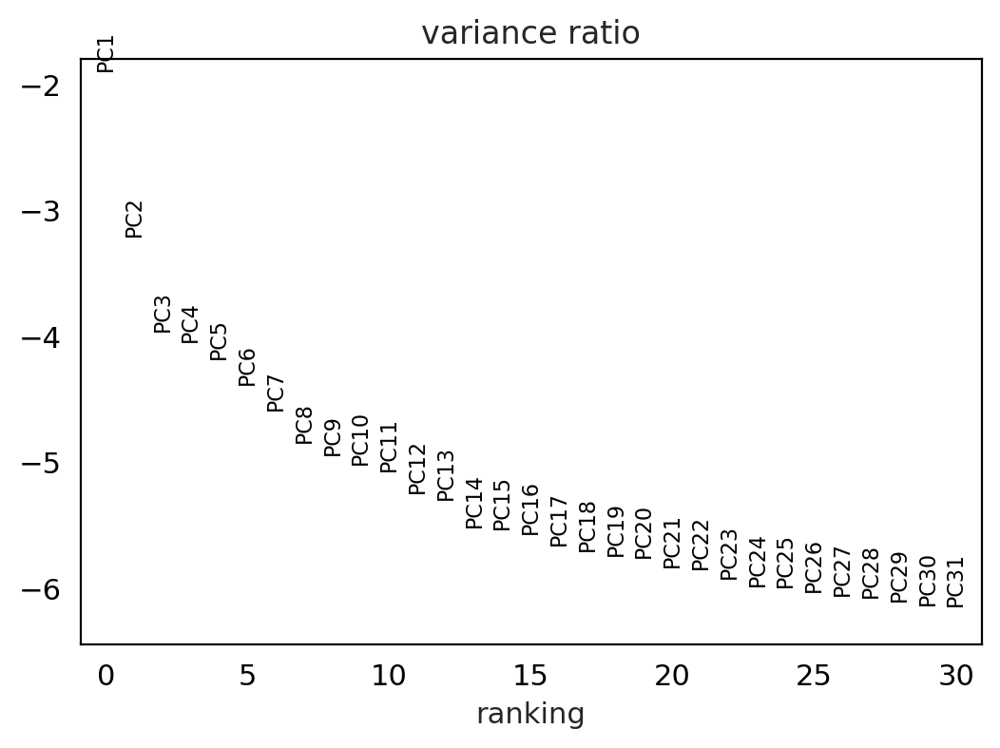

In [13]:
brq_all = brq
sc.pp.highly_variable_genes(brq_all)

sc.tl.pca(brq_all, svd_solver='arpack', use_highly_variable=True)
scv.pp.neighbors(brq_all) 
sc.pl.pca_variance_ratio(brq_all, log=True)

In [14]:
scv.pp.moments(brq_all, n_pcs=30, n_neighbors=30) 
scv.tl.umap(brq_all)

computing moments based on connectivities
    finished (0:00:09) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


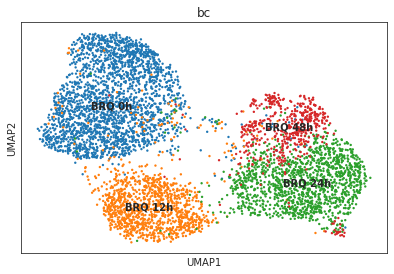

In [116]:
sc.pl.scatter(brq_all, color=['bc'], 
              basis='umap', legend_loc='on data')

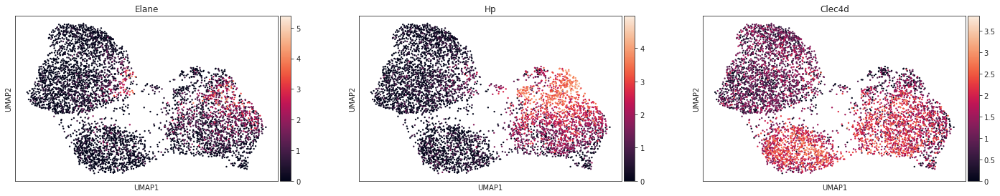

In [117]:
sc.pl.scatter(brq_all, color=['Elane', 'Hp', 'Clec4d'], basis='umap')

... storing 'bc' as categorical


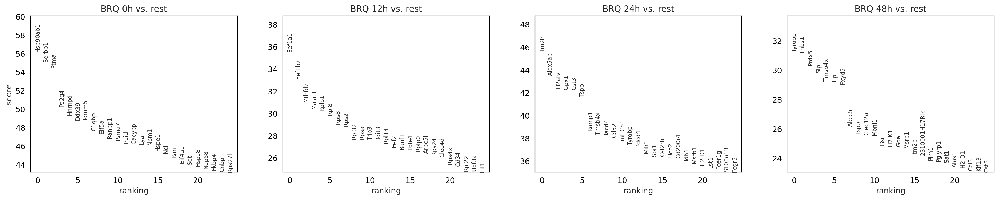

In [15]:
sc.tl.rank_genes_groups(brq_all, 'bc', method='wilcoxon', key_added = "wilcoxon")
sc.pl.rank_genes_groups(brq_all, n_genes=25, sharey=False, key="wilcoxon")

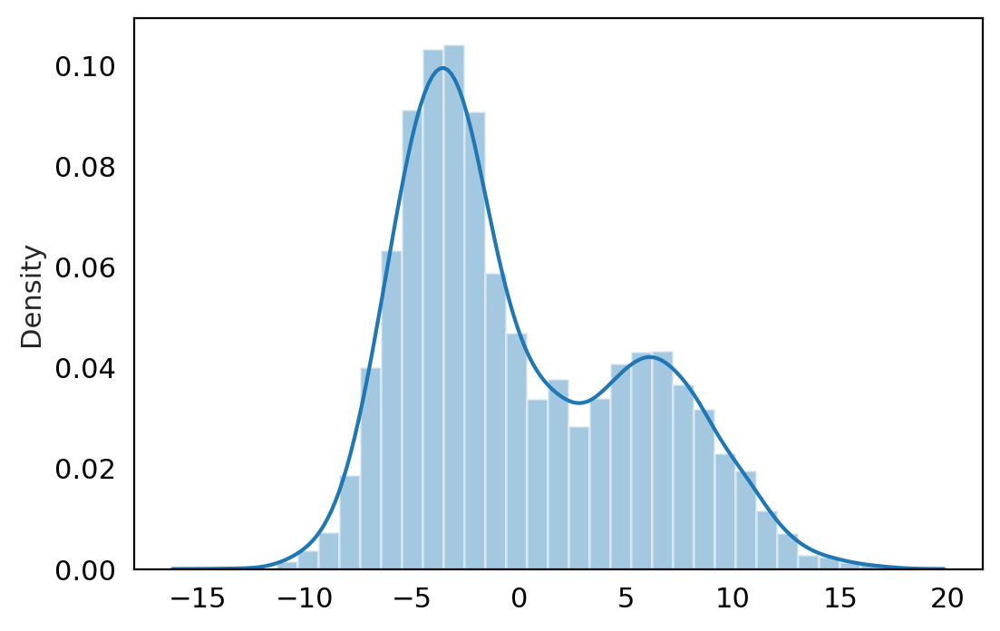

In [55]:
# calculating granulocyte score
gran_sig = ["Spi1", "Clec4d", "Tyrobp", "Csf2rb", "Mpo", "Fcer1g", "Fcgr3", "Slpi", "Sell"]
gran_idx = [np.where(brq_all.var.index == x)[0][0] for x in gran_sig]
gran_spliced = pd.DataFrame.sparse.from_spmatrix(brq_all.layers["spliced"][:,gran_idx])
gran_spliced.columns = gran_sig

gran_spliced_log = np.log2(gran_spliced+1)
gran_spliced_z = (gran_spliced_log - np.mean(gran_spliced_log, axis=0))/\
np.array(np.std(np.matrix(gran_spliced_log), axis=0))[0]

gran_spliced_score = np.sum(gran_spliced_z, axis=1)
sns.distplot(gran_spliced_score)

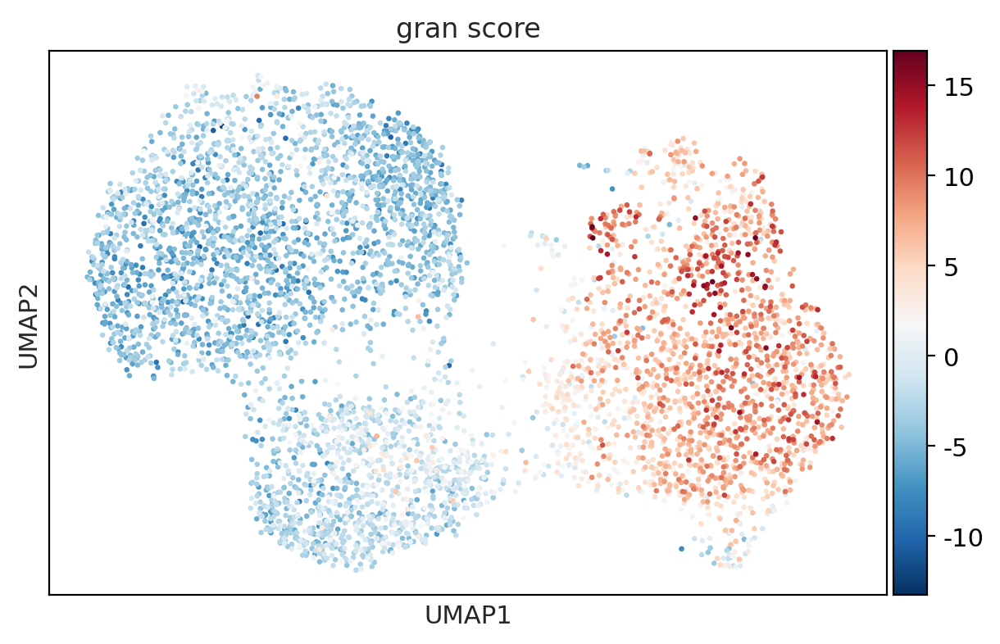

In [60]:
brq_all.obs["gran_score"] = np.array(gran_spliced_score)
sc.pl.scatter(brq_all, color=['gran_score'], basis='umap', legend_loc='on data')

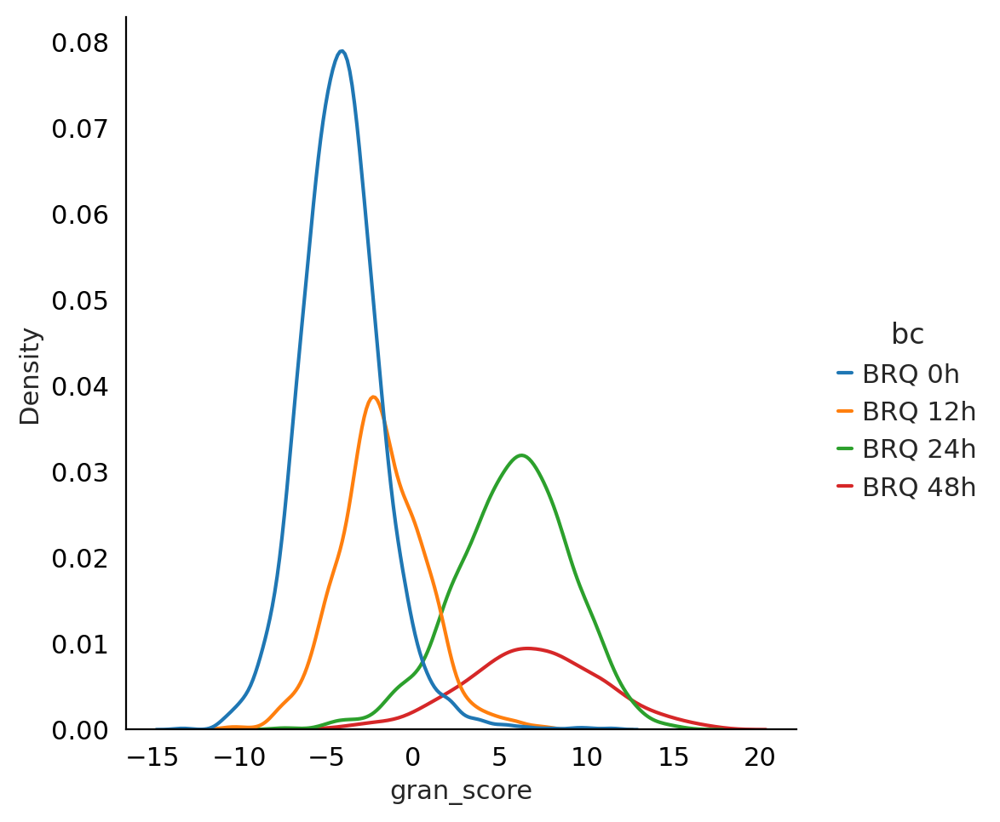

In [65]:
sns.displot(brq_all.obs, x="gran_score", hue="bc", kind="kde")

In [73]:
umap_data_all = pd.DataFrame(brq_all.obsm["X_umap"])
umap_data_all["bc"] = pd.Series(np.array(brq_all.obs["bc"]), dtype="category")
umap_data_all.to_csv("220512_brq_all_umap.csv")

In [93]:
print(np.where(brq_all.var.index == "Ung"))
print(np.where(brq_all.var.index == "Pcna"))
print(np.where(brq_all.var.index == "Rrm2"))
print(np.where(brq_all.var.index == "Aurka"))
print(np.where(brq_all.var.index == "Spi1"))
print(np.where(brq_all.var.index == "Gsn"))
print(np.where(brq_all.var.index == "Clec4d"))
print(np.where(brq_all.var.index == "Fcgr3"))

(array([3279]),)
(array([1315]),)
(array([8185]),)
(array([1525]),)
(array([1088]),)
(array([923]),)
(array([4078]),)
(array([557]),)


In [94]:
spliced_all = pd.DataFrame.sparse.from_spmatrix(brq_all.layers["spliced"][:,[3279, 1315, 8185, 1525, 1088, 923, 4078, 557]])
spliced_all.columns = ["Ung", "Pcna", "Rrm2", "Aurka", "Spi1", "Gsn", "Clec4d", "Fcgr3"]
#spliced["lambda"] = np.array(pt["lambda"])
spliced_all["bc"] = np.array(brq_all.obs["bc"])
spliced_all.to_csv("220504_brq_all_spliced.csv")
spliced_all.head()

,Ung,Pcna,Rrm2,Aurka,Spi1,Gsn,Clec4d,Fcgr3,bc
0,0.000000,1.173317,2.346633,1.173317,19.946383,4.693266,1.173317,3.519950,BRQ 48h
1,0.590222,0.590222,11.214219,0.000000,1.180444,0.000000,2.951110,1.180444,BRQ 0h
2,2.884969,0.721242,2.163727,0.000000,1.442485,0.000000,0.721242,0.000000,BRQ 0h
3,0.000000,0.000000,3.132576,2.088384,9.397730,4.176769,1.044192,2.088384,BRQ 0h
4,0.000000,0.000000,2.166429,2.166429,10.832144,6.499287,1.083214,21.664288,BRQ 24h


In [118]:
scv.tl.velocity(brq_all, use_highly_variable=True)  
scv.tl.velocity_graph(brq_all)

computing velocities
    finished (0:00:17) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:03:35) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


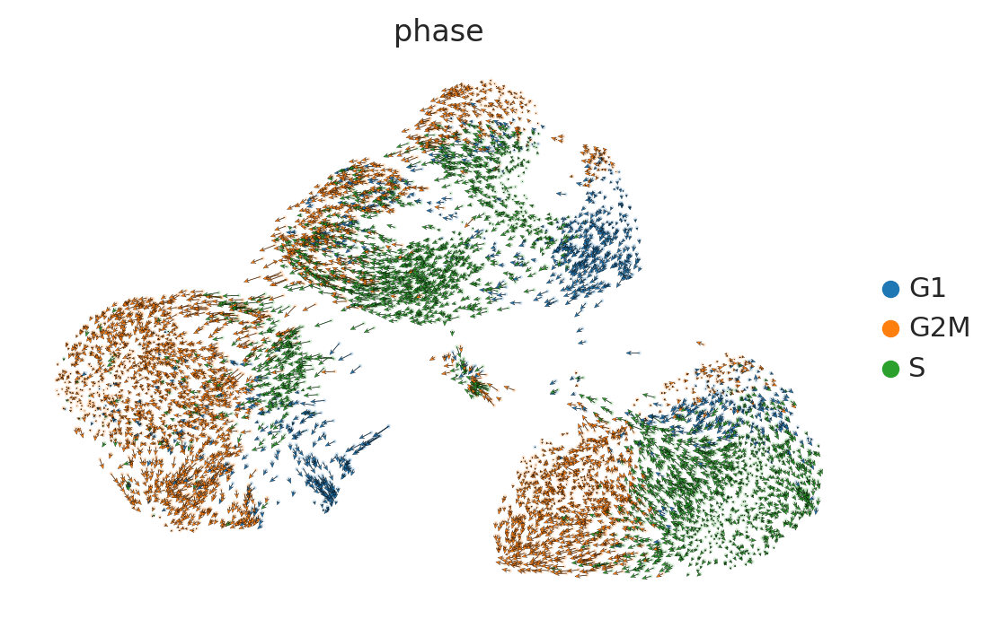

In [56]:
scv.pl.velocity_embedding(brq_unique, basis='umap', arrow_length=6, arrow_size=1, 
                          color="phase", legend_loc="right margin")

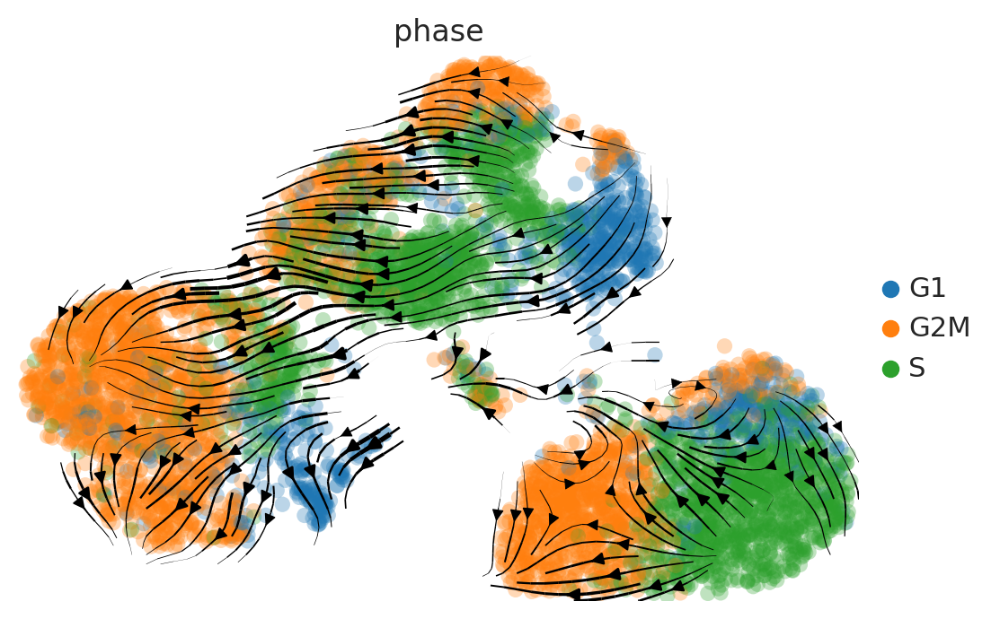

In [58]:
scv.pl.velocity_embedding_stream(brq_unique, basis='umap', color="phase", 
                                 legend_loc="right margin")

In [59]:
scv.tl.rank_velocity_genes(brq_all, groupby='bc')

ranking velocity genes
    finished (0:00:26) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)


In [60]:
pd.DataFrame(brq.uns['rank_velocity_genes']['names']).head(30)

,BRQ 0h,BRQ 12h,BRQ 24h,BRQ 48h,BRQ 6h
0,Kxd1,Rbms3,Iqsec1,Fermt3,Aoah
1,Rpl29,Fam129a,Fam49b,Tmem126a,Serpinb1a
2,Rpl34,Akap13,Nxpe5,Plek,Tenm4
3,Chrac1,Dab2,Cpa3,Hspa4,Cacybp
4,Rpl30,Zc3hav1,Mettl1,Nckap1l,Cd69
5,Rpl32,Hlf,Ap3s1,Cltc,AC133103.1
6,Gas5,Eya2,Myo1d,Tgm2,Galnt3
7,Rps14,Tspan2,Gm2788,Ncf2,H2-K1
8,Hnrnpa2b1,Iqgap2,Ptprj,Ppm1g,Inpp4b
9,Calr,Pbx3,Maml2,Utp4,Extl3


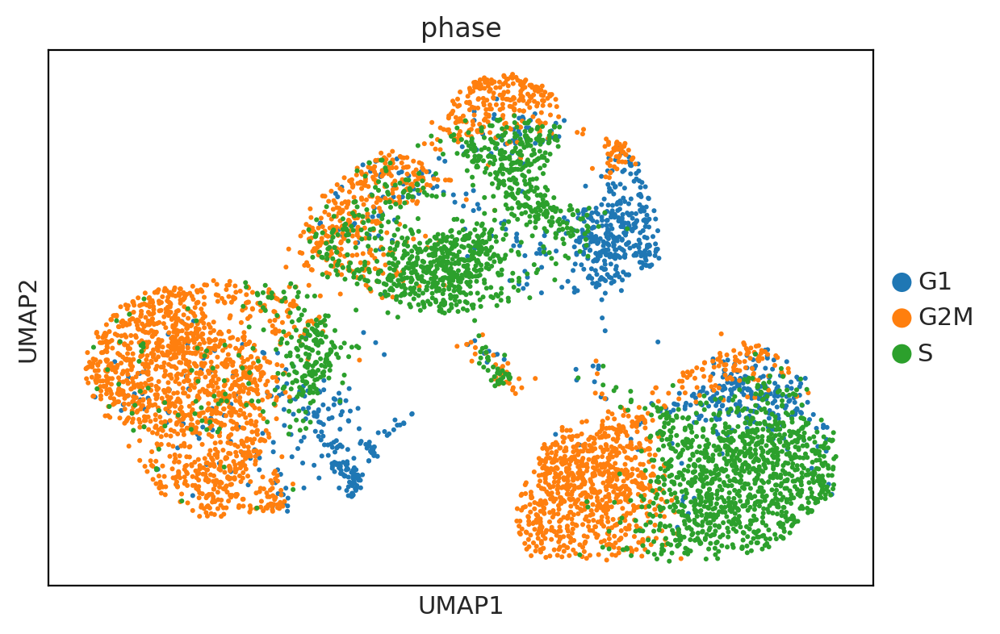

In [61]:
scv.tl.umap(brq_unique)
sc.pl.scatter(brq_unique, basis="umap", color='phase')

saving figure to file ./figures/scvelo_220501_brq.png


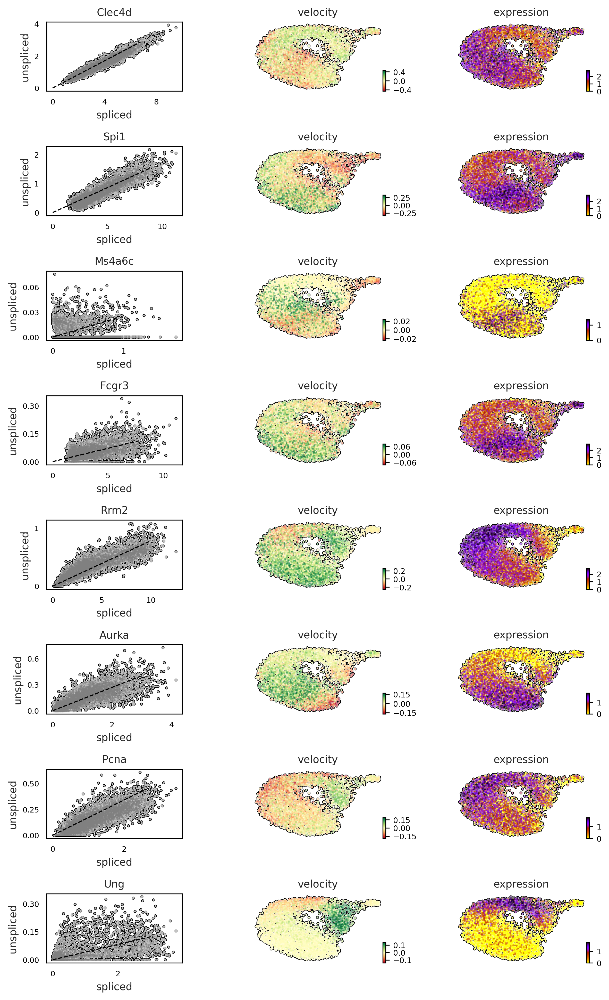

In [190]:
# https://github.com/theislab/scvelo/issues/116
scv.pl.velocity(brq, 
                var_names=['Clec4d', 'Spi1', 'Ms4a6c', 'Fcgr3', 'Rrm2', 'Aurka', 'Pcna', 'Ung'], 
                layers=['velocity', 'X'], add_outline=True,

                ncols=1, save="220501_brq.png", dpi=150)

## Look at all BRQ cells in cell-cycle space

computing neighbors
    finished (0:00:01) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)


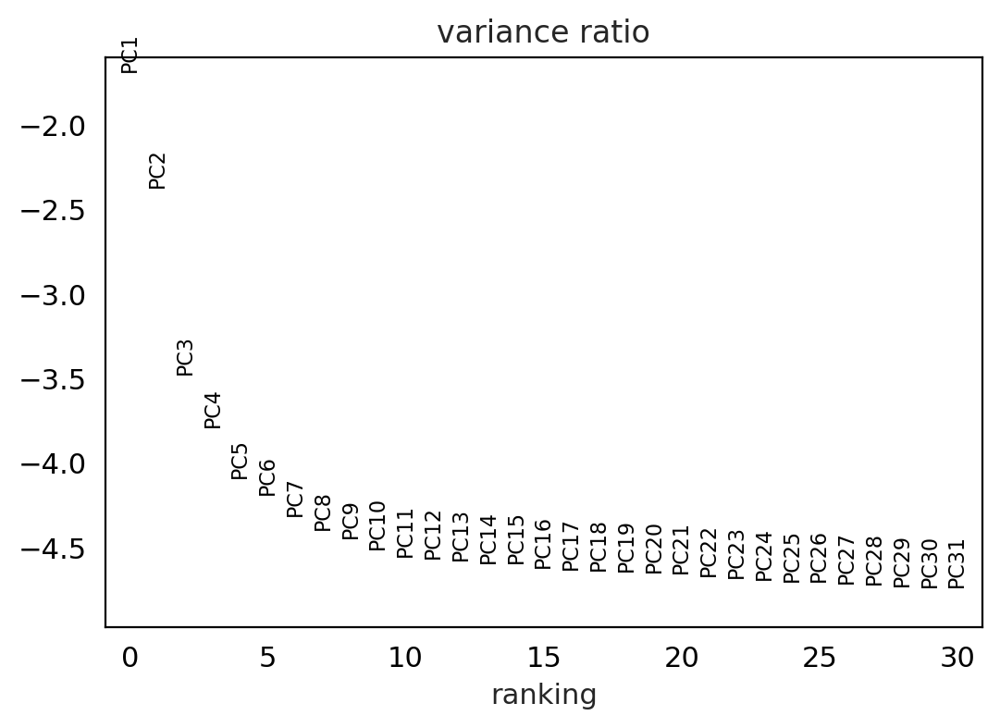

In [66]:
sc.pp.highly_variable_genes(brq)
brq.var["highly_variable"] = False
brq.var["highly_variable"].loc[sgenes] = True
brq.var["highly_variable"].loc[g2mgenes] = True

sc.tl.pca(brq, svd_solver='arpack', use_highly_variable=True)
scv.pp.neighbors(brq) 
sc.pl.pca_variance_ratio(brq, log=True)

In [67]:
scv.pp.moments(brq, n_pcs=30, n_neighbors=30) 
scv.tl.umap(brq)
sum(brq.var["highly_variable"])

computing moments based on connectivities
    finished (0:00:09) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


93

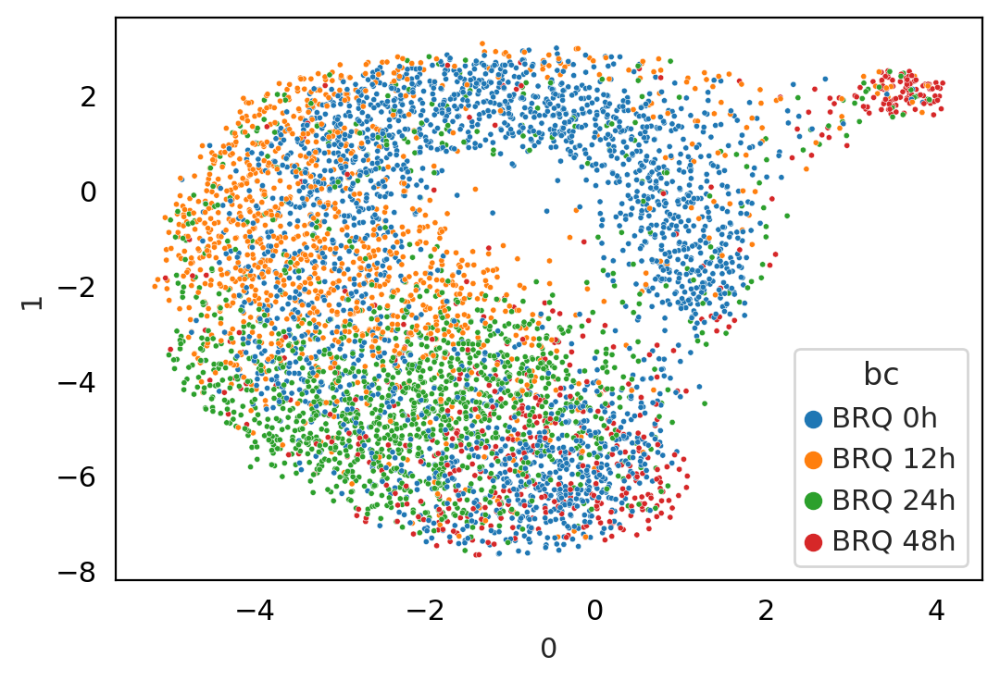

In [76]:
umap_data = pd.DataFrame(brq.obsm["X_umap"])
umap_data["bc"] = pd.Series(np.array(brq.obs["bc"]), dtype="category")
umap_data["gran_score"] = pd.Series(np.array(brq_all.obs["gran_score"]))
umap_data.to_csv("220504_brq_cellcycle_umap.csv")

sns.scatterplot(x=umap_data[0], y=umap_data[1], hue=umap_data["bc"], s=5)

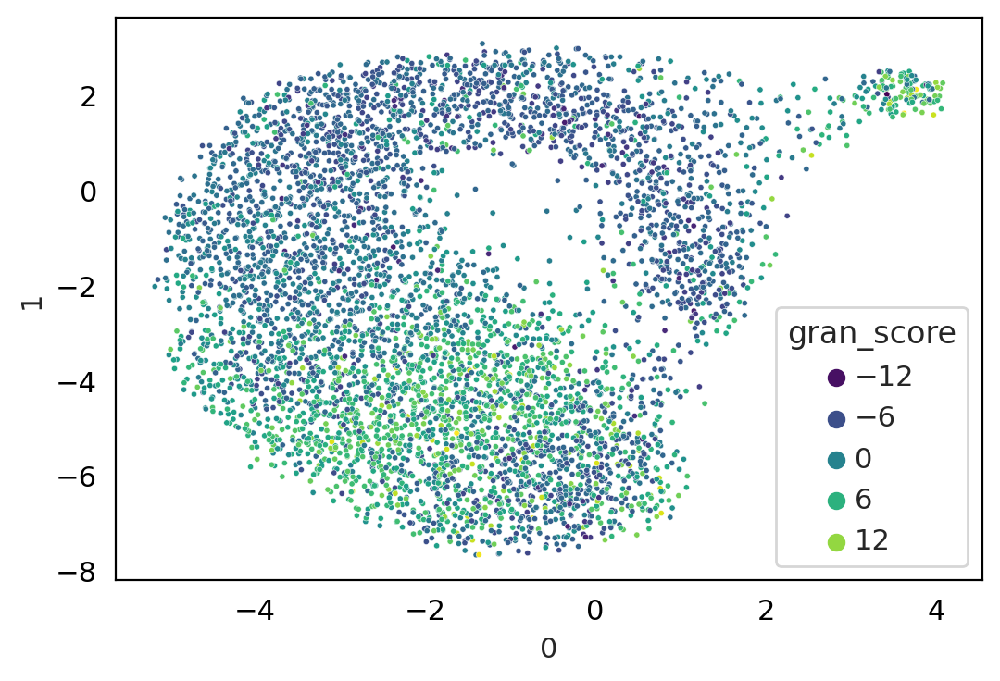

In [74]:
sns.scatterplot(x=umap_data[0], y=umap_data[1], hue=umap_data["gran_score"], s=5, palette="viridis")

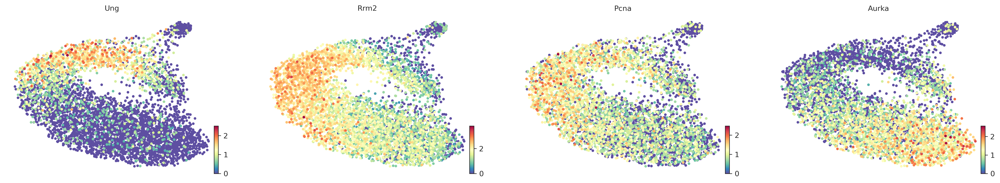

In [113]:
scv.pl.scatter(brq, color=["Ung", "Rrm2", "Pcna", "Aurka"], cmap="Spectral_r",
               size = 50, alpha=1, dpi=300)

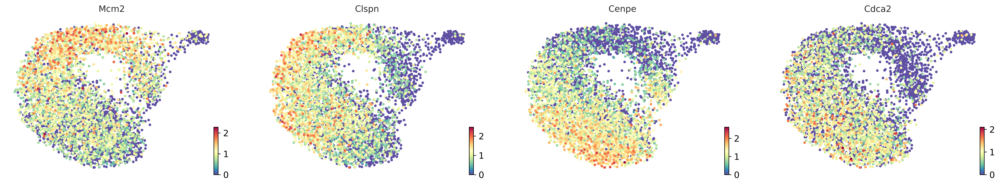

In [91]:
scv.pl.scatter(brq, color=["Mcm2", "Clspn", "Cenpe", "Cdca2"], cmap="Spectral_r",
               size = 50, alpha=1, dpi=300)

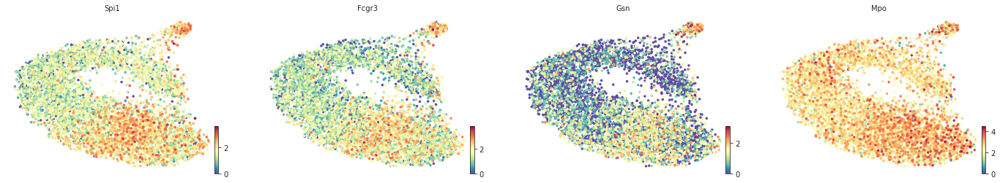

In [45]:
scv.pl.scatter(brq, color=["Spi1", "Fcgr3", "Gsn", "Mpo"], cmap="Spectral_r", size = 50)

In [48]:
pt = pd.read_csv("220504_brq_cellcycle_pcdata.csv", index_col=0)
pt.head()

,X0,X1,lambda
1,0.274316,-5.206223,14.111764
2,-4.506260,-0.890033,7.268031
3,-2.383697,1.411857,3.629418
4,0.598583,-5.315491,14.453945
5,-1.681554,-4.452416,12.014200


In [60]:
z = brq[brq.obs['leiden'] != '5']  # just to plot pseudotimes here
z.obs["pt_lambda"] = np.array(pt["lambda"])
z.obs.head()

Trying to set attribute `.obs` of view, copying.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


,bcs,n_counts,bc,velocity_self_transition,velocity_length,velocity_confidence,velocity_confidence_transition,leiden,pt_lambda
bcs,,,,,,,,,
AAACCCAAGGTCGTAG,AAACCCAAGGTCGTAG,12145.000977,BRQ 48h,0.175508,38.200001,0.833800,0.113298,3,14.111764
AAACCCACACAATTCG,AAACCCACACAATTCG,12144.999023,BRQ 0h,0.140052,23.080000,0.874569,0.308526,1,7.268031
AAACCCACACGGTCTG,AAACCCACACGGTCTG,12144.999023,BRQ 0h,0.090578,22.280001,0.839865,0.181194,1,3.629418
AAACCCAGTAATTAGG,AAACCCAGTAATTAGG,12144.999023,BRQ 0h,0.201722,35.849998,0.759972,0.140581,3,14.453945
AAACCCAGTCCAAATC,AAACCCAGTCCAAATC,12145.000000,BRQ 24h,0.068073,53.889999,0.927954,0.044661,0,12.014200


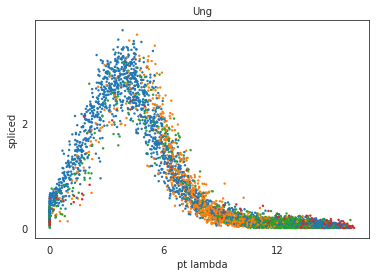

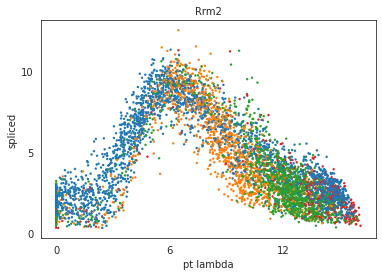

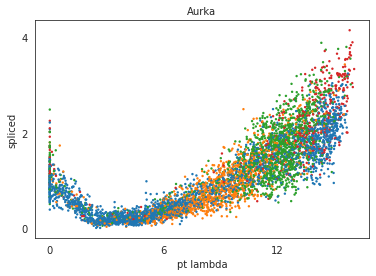

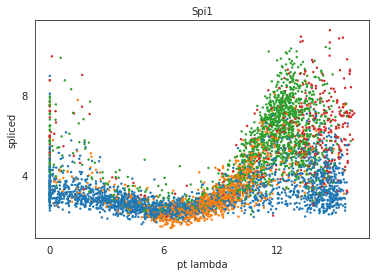

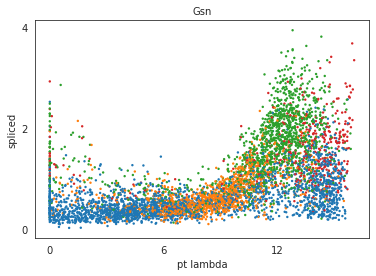

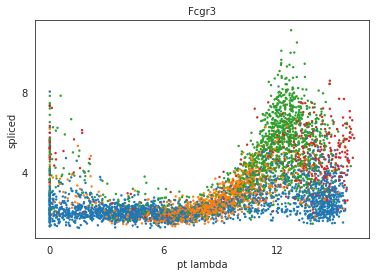

In [53]:
scv.pl.scatter(z, x="pt_lambda", y="Ung", color="bc")
scv.pl.scatter(z, x="pt_lambda", y="Rrm2", color="bc")
scv.pl.scatter(z, x="pt_lambda", y="Aurka", color="bc")
scv.pl.scatter(z, x="pt_lambda", y="Spi1", color="bc")
scv.pl.scatter(z, x="pt_lambda", y="Gsn", color="bc")
scv.pl.scatter(z, x="pt_lambda", y="Fcgr3", color="bc")

In [57]:
print(np.where(z.var.index == "Ung"))
print(np.where(z.var.index == "Pcna"))
print(np.where(z.var.index == "Rrm2"))
print(np.where(z.var.index == "Aurka"))
print(np.where(z.var.index == "Spi1"))
print(np.where(z.var.index == "Gsn"))
print(np.where(z.var.index == "Fcgr3"))

(array([3279]),)
(array([1315]),)
(array([8185]),)
(array([1525]),)
(array([1088]),)
(array([923]),)
(array([557]),)


In [104]:
genes = ["Ung", "Pcna", "Rrm2", "Aurka", "Mcm2", "Clspn", "Cdca2", "Cenpe", "Spi1", "Gsn", "Fcgr3", "Tyrobp"]
genes_idx = [np.where(brq.var.index == x)[0][0] for x in genes]
genes_spliced = pd.DataFrame.sparse.from_spmatrix(brq.layers["spliced"][:,genes_idx])
genes_spliced.columns = genes

#spliced["lambda"] = np.array(pt["lambda"])
genes_spliced["bc"] = np.array(brq.obs["bc"])
genes_spliced.to_csv("220504_brq_cellcycle_spliced.csv")
genes_spliced.head()


,Ung,Pcna,Rrm2,Aurka,Mcm2,Clspn,Cdca2,Cenpe,Spi1,Gsn,Fcgr3,Tyrobp,bc
0,0.000000,1.173317,2.346633,1.173317,1.173317,0.000000,0.000000,2.346633,19.946383,4.693266,3.519950,39.892765,BRQ 48h
1,0.590222,0.590222,11.214219,0.000000,2.360888,0.590222,0.000000,0.000000,1.180444,0.000000,1.180444,4.131555,BRQ 0h
2,2.884969,0.721242,2.163727,0.000000,0.721242,1.442485,0.721242,0.000000,1.442485,0.000000,0.000000,3.606212,BRQ 0h
3,0.000000,0.000000,3.132576,2.088384,2.088384,0.000000,1.044192,2.088384,9.397730,4.176769,2.088384,25.060612,BRQ 0h
4,0.000000,0.000000,2.166429,2.166429,0.000000,2.166429,0.000000,5.416072,10.832144,6.499287,21.664288,17.331430,BRQ 24h


## Estrogen w/d

Trying to set attribute `.uns` of view, copying.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


computing neighbors
    finished (0:00:01) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)


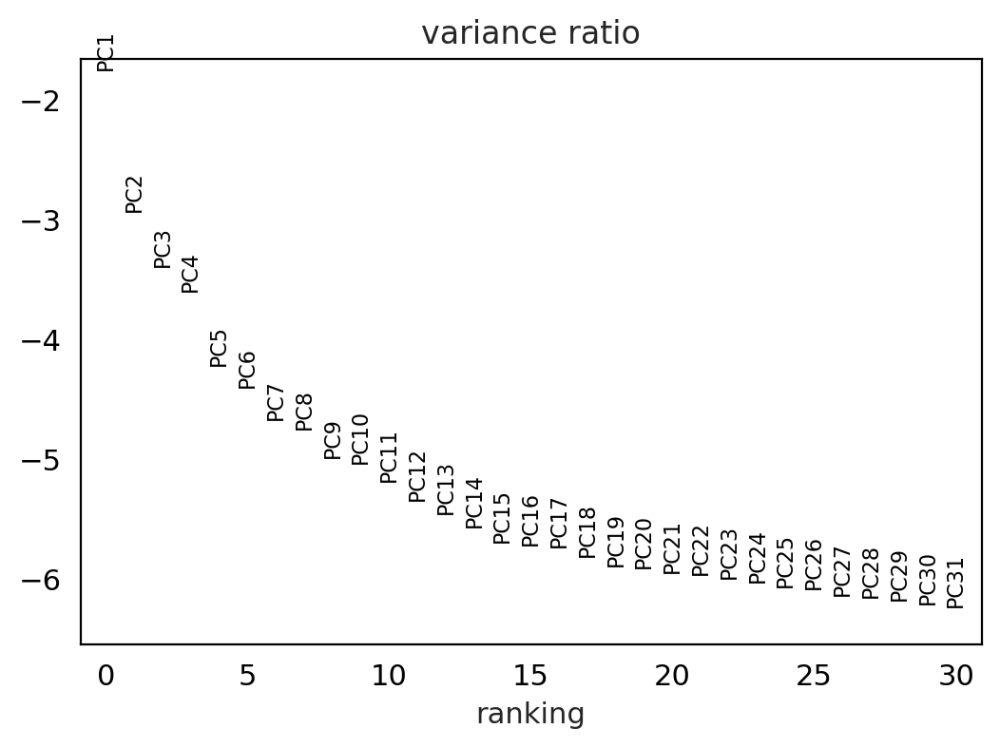

computing moments based on connectivities
    finished (0:00:08) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [95]:
e2w = e2w[~e2w.obs.bc.isin(["E2 w/d 6h"])]  # getting rid of BRQ 6h because its G1 cells are a little weird
e2w_all = e2w

sc.pp.highly_variable_genes(e2w_all)
sc.tl.pca(e2w_all, svd_solver='arpack', use_highly_variable=True)
scv.pp.neighbors(e2w_all) 
sc.pl.pca_variance_ratio(e2w_all, log=True)

scv.pp.moments(e2w_all, n_pcs=30, n_neighbors=30)
scv.tl.umap(e2w_all)
# scv.tl.velocity(e2w)
# scv.tl.velocity_graph(e2w)

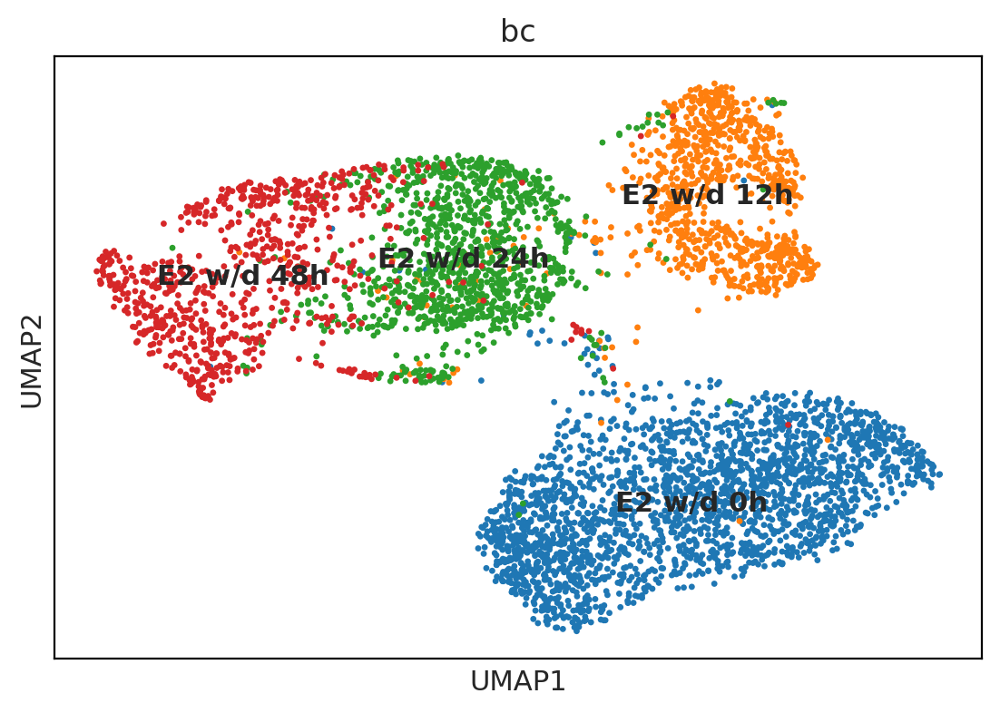

In [96]:
sc.pl.scatter(e2w_all, color=['bc'], 
              basis='umap', legend_loc='on data')

In [97]:
e2w_umap_data_all = pd.DataFrame(e2w_all.obsm["X_umap"])
e2w_umap_data_all["bc"] = pd.Series(np.array(e2w_all.obs["bc"]), dtype="category")
e2w_umap_data_all.to_csv("220512_e2w_all_umap.csv")

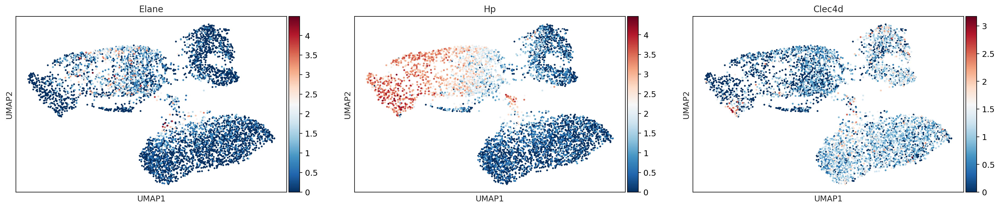

In [79]:
sc.pl.scatter(e2w_all, color=['Elane', 'Hp', 'Clec4d'], basis='umap')

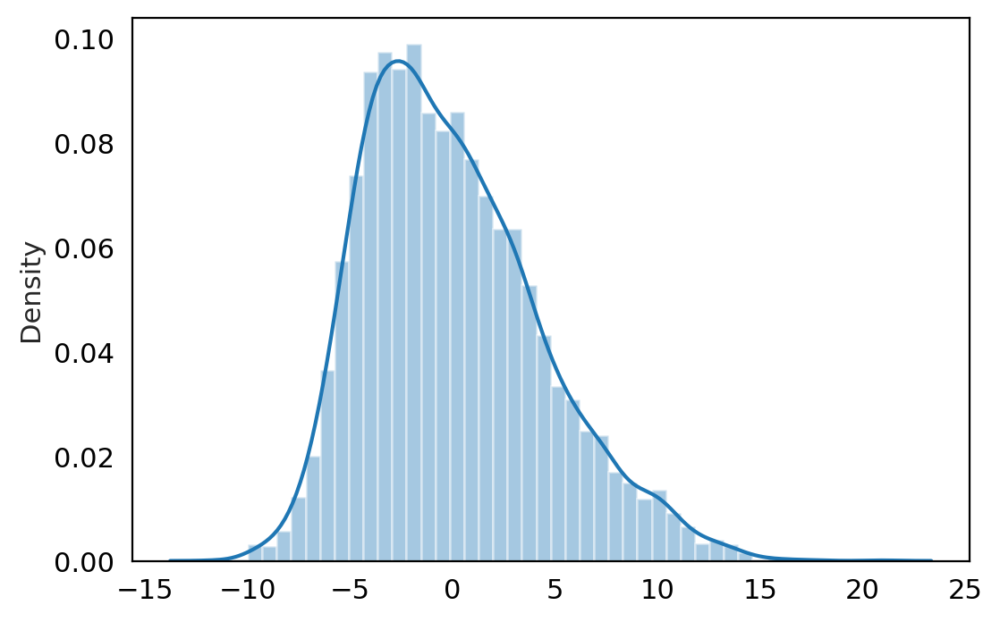

In [83]:
# calculating granulocyte score
e2w_gran_sig = ["Spi1", "Clec4d", "Tyrobp", "Csf2rb", "Mpo", "Fcer1g", "Fcgr3", "Slpi", "Sell"]
e2w_gran_idx = [np.where(e2w_all.var.index == x)[0][0] for x in e2w_gran_sig]
e2w_gran_spliced = pd.DataFrame.sparse.from_spmatrix(e2w_all.layers["spliced"][:,e2w_gran_idx])
e2w_gran_spliced.columns = e2w_gran_sig

e2w_gran_spliced_log = np.log2(e2w_gran_spliced+1)
e2w_gran_spliced_z = (e2w_gran_spliced_log - np.mean(e2w_gran_spliced_log, axis=0))/\
np.array(np.std(np.matrix(e2w_gran_spliced_log), axis=0))[0]

e2w_gran_spliced_score = np.sum(e2w_gran_spliced_z, axis=1)
sns.distplot(e2w_gran_spliced_score)

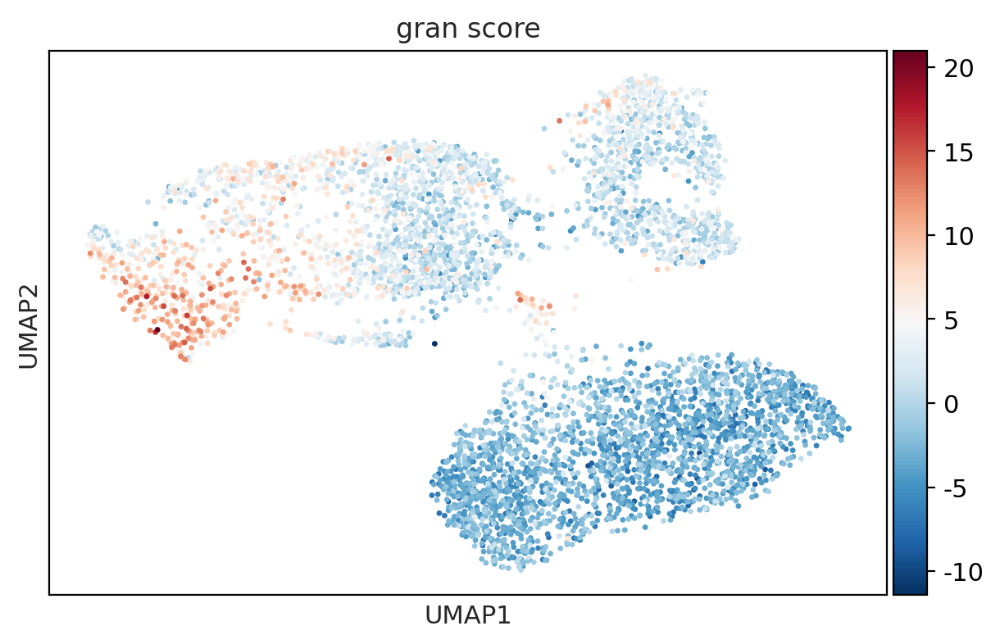

In [101]:
e2w_all.obs["gran_score"] = np.array(e2w_gran_spliced_score)
sc.pl.scatter(e2w_all, color=['gran_score'], basis='umap', legend_loc='on data')

In [100]:
genes = ["Spi1", "Clec4d", "Tyrobp", "Csf2rb", "Mpo", "Fcer1g", "Fcgr3", "Slpi", "Sell", "Gsn"]
genes_idx = [np.where(e2w_all.var.index == x)[0][0] for x in genes]
e2w_spliced_all = pd.DataFrame.sparse.from_spmatrix(e2w_all.layers["spliced"][:,genes_idx])
e2w_spliced_all.columns = genes
#spliced["lambda"] = np.array(pt["lambda"])
e2w_spliced_all["bc"] = np.array(e2w_all.obs["bc"])
e2w_spliced_all.to_csv("220504_e2w_all_spliced.csv")
e2w_spliced_all.head()

,Spi1,Clec4d,Tyrobp,Csf2rb,Mpo,Fcer1g,Fcgr3,Slpi,Sell,Gsn,bc
0,13.497777,1.499753,37.493824,0.0,0.000000,26.995554,5.999012,50.991600,0.000000,0.000000,E2 w/d 48h
1,8.138989,1.627798,53.717327,0.0,17.905777,22.789169,4.883393,4.883393,0.000000,6.511191,E2 w/d 12h
2,8.109282,4.054641,14.867016,0.0,13.515469,32.437126,4.054641,0.000000,1.351547,0.000000,E2 w/d 12h
3,1.180444,2.951110,4.131555,0.0,12.984885,7.672887,1.180444,2.951110,0.000000,0.000000,E2 w/d 0h
4,1.442485,0.721242,3.606212,0.0,17.309814,18.031057,0.000000,0.000000,0.000000,0.000000,E2 w/d 0h


computing neighbors
    finished (0:00:01) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)


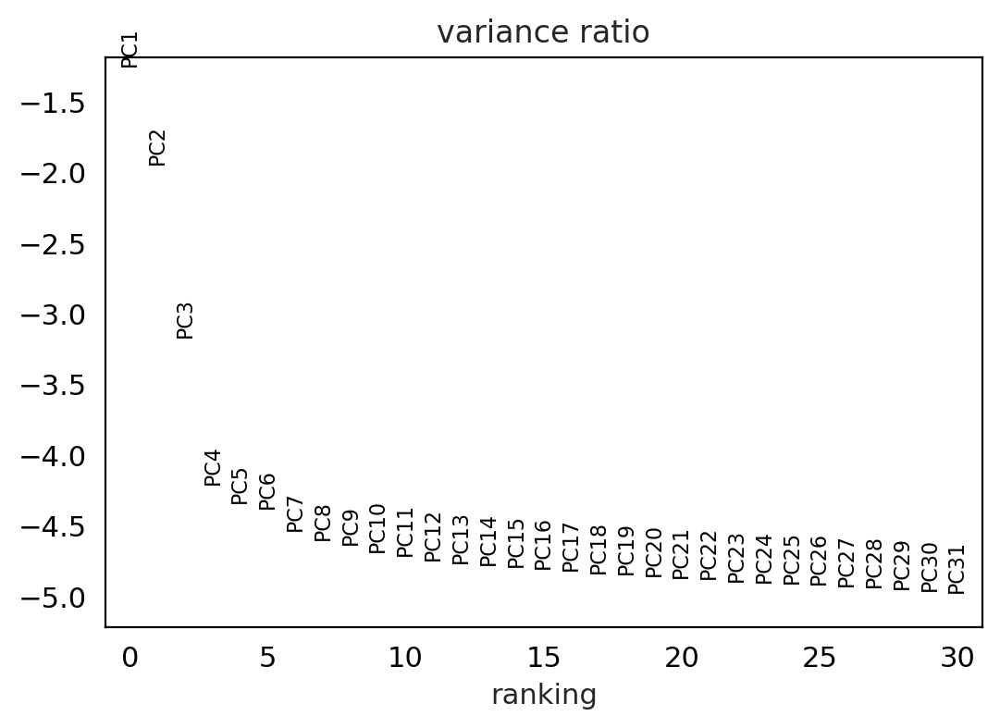

computing moments based on connectivities
    finished (0:00:08) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [81]:
# Cell cycle only

sc.pp.highly_variable_genes(e2w)
e2w.var["highly_variable"] = False
e2w.var["highly_variable"].loc[sgenes] = True
e2w.var["highly_variable"].loc[g2mgenes] = True

sc.tl.pca(e2w, svd_solver='arpack', use_highly_variable=True)
scv.pp.neighbors(e2w) 
sc.pl.pca_variance_ratio(e2w, log=True)

scv.pp.moments(e2w, n_pcs=30, n_neighbors=30)
scv.tl.umap(e2w)
# scv.tl.velocity(e2w)
# scv.tl.velocity_graph(e2w)

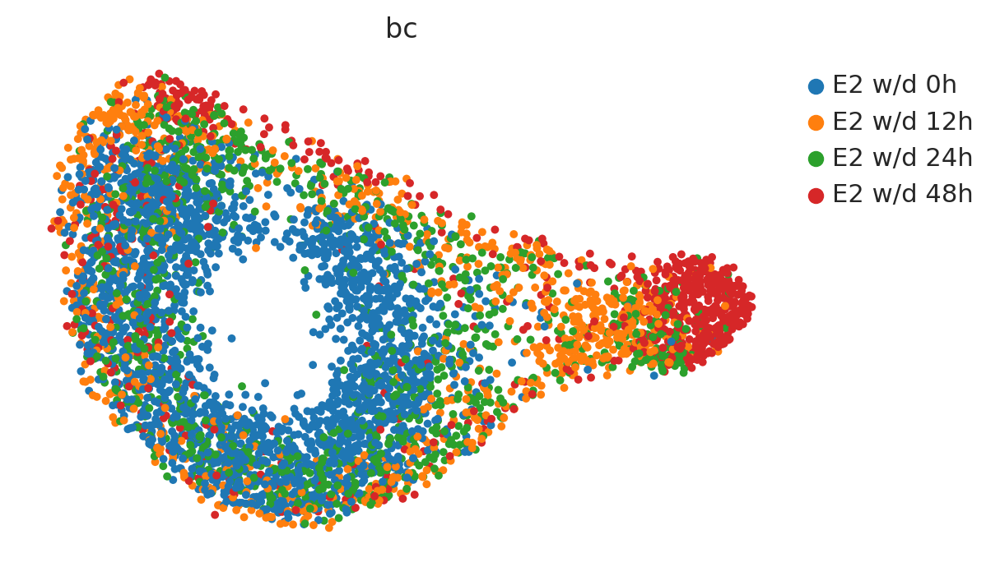

In [82]:
scv.pl.scatter(e2w, color="bc", size = 50)

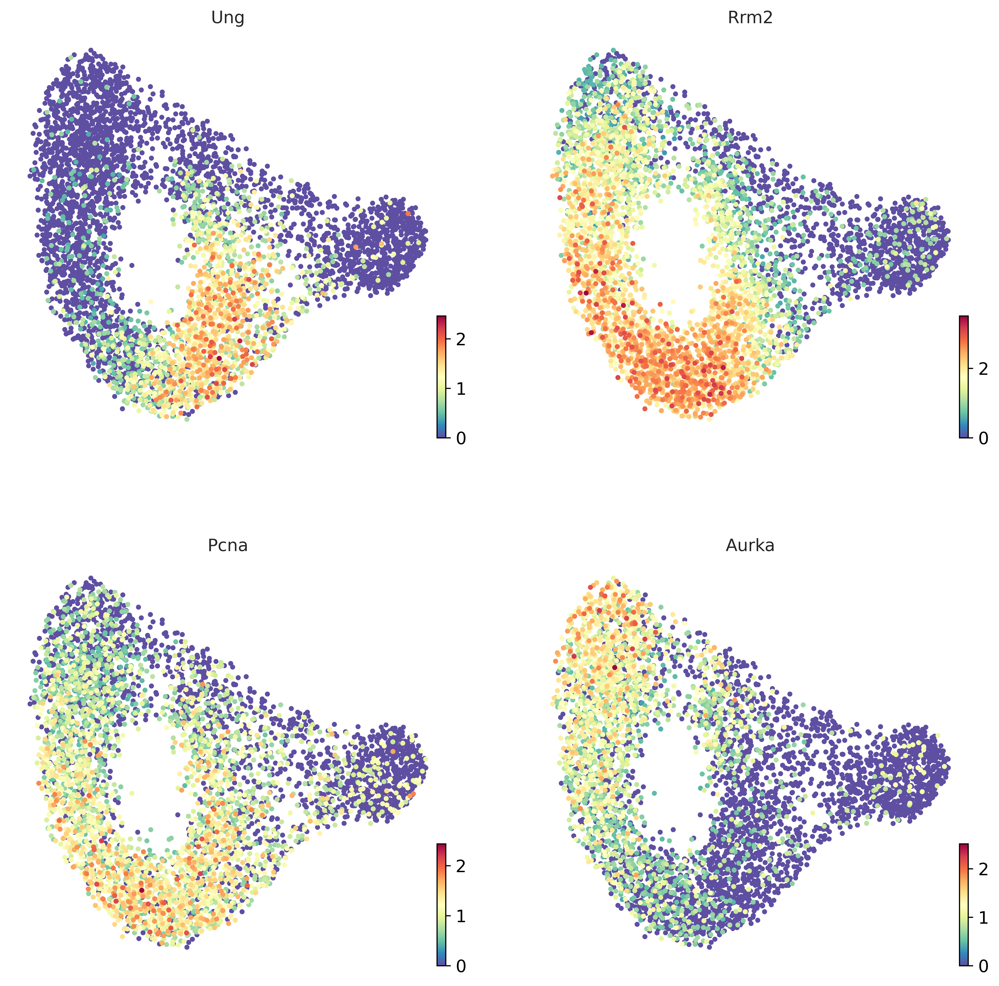

In [84]:
scv.pl.scatter(e2w, color=["Ung", "Rrm2", "Pcna", "Aurka"], cmap="Spectral_r",
               size = 50, alpha=1, dpi=300, figsize=[6,6], nrows=2)

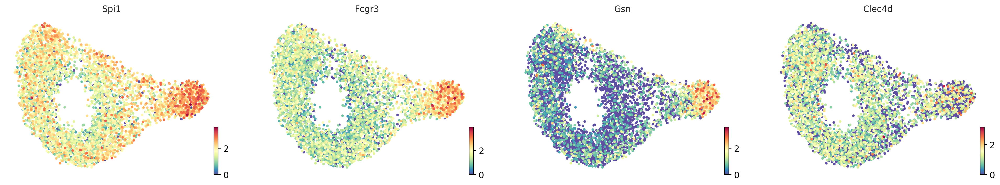

In [85]:
scv.pl.scatter(e2w, color=["Spi1", "Fcgr3", "Gsn", "Clec4d"], cmap="Spectral_r", size = 50)

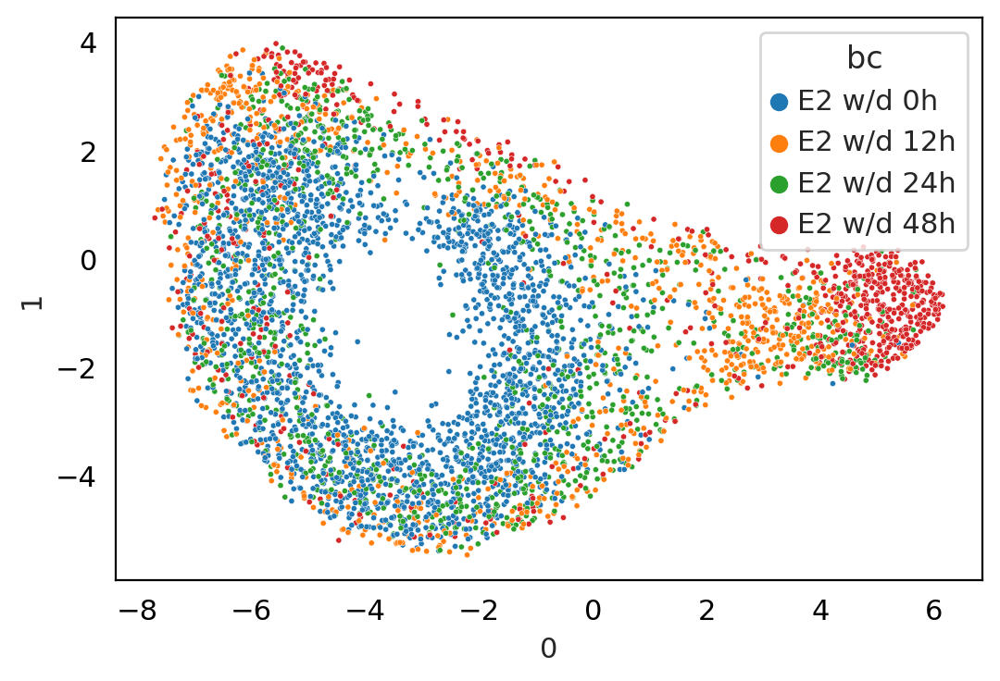

In [89]:
e2w_umap_data = pd.DataFrame(e2w.obsm["X_umap"])
e2w_umap_data["bc"] = pd.Series(np.array(e2w.obs["bc"]), dtype="category")
e2w_umap_data["gran_score"] = pd.Series(np.array(e2w_all.obs["gran_score"]))
e2w_umap_data.to_csv("220513_e2w_cellcycle_umap.csv")

sns.scatterplot(x=e2w_umap_data[0], y=e2w_umap_data[1], hue=e2w_umap_data["bc"], s=5)

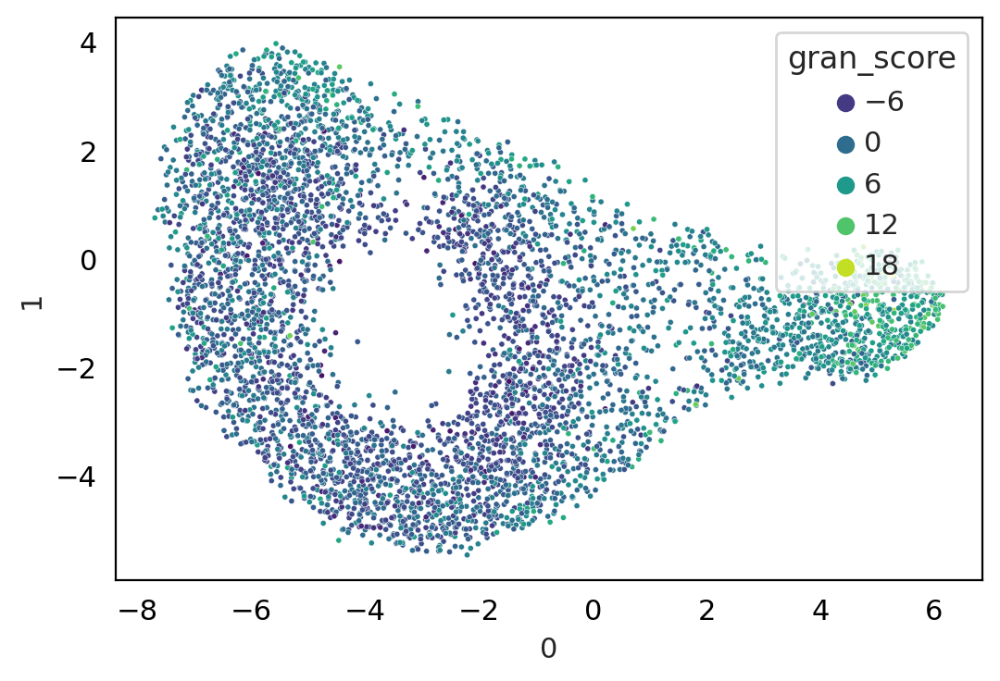

In [90]:
sns.scatterplot(x=e2w_umap_data[0], y=e2w_umap_data[1], hue=e2w_umap_data["gran_score"], s=5, palette="viridis")

In [102]:
genes = ["Ung", "Pcna", "Rrm2", "Aurka", "Mcm2", "Clspn", "Cdca2", "Cenpe", "Spi1", "Gsn", "Fcgr3"]
genes_idx = [np.where(e2w.var.index == x)[0][0] for x in genes]
e_genes_spliced = pd.DataFrame.sparse.from_spmatrix(e2w.layers["spliced"][:,genes_idx])
e_genes_spliced.columns = genes

#spliced["lambda"] = np.array(pt["lambda"])
e_genes_spliced["bc"] = np.array(e2w.obs["bc"])
e_genes_spliced.to_csv("220504_e2w_cellcycle_spliced.csv")
e_genes_spliced.head()


,Ung,Pcna,Rrm2,Aurka,Mcm2,Clspn,Cdca2,Cenpe,Spi1,Gsn,Fcgr3,bc
0,1.499753,0.000000,13.497777,0.0,1.499753,4.499259,0.000000,0.000000,13.497777,0.000000,5.999012,E2 w/d 48h
1,0.000000,0.000000,0.000000,0.0,1.627798,0.000000,0.000000,0.000000,8.138989,6.511191,4.883393,E2 w/d 12h
2,0.000000,1.351547,2.703094,0.0,0.000000,0.000000,0.000000,4.054641,8.109282,0.000000,4.054641,E2 w/d 12h
3,0.590222,0.590222,11.214219,0.0,2.360888,0.590222,0.000000,0.000000,1.180444,0.000000,1.180444,E2 w/d 0h
4,2.884969,0.721242,2.163727,0.0,0.721242,1.442485,0.721242,0.000000,1.442485,0.000000,0.000000,E2 w/d 0h


In [106]:
genes = ["Ung", "Pcna", "Rrm2", "Aurka", "Mcm2", "Clspn", "Cdca2", "Cenpe", "Spi1", "Gsn", "Fcgr3", "Tyrobp"]
genes_idx = [np.where(e2w.var.index == x)[0][0] for x in genes]
e_genes_spliced = pd.DataFrame.sparse.from_spmatrix(e2w.layers["spliced"][:,genes_idx])
e_genes_spliced.columns = genes

#spliced["lambda"] = np.array(pt["lambda"])
e_genes_spliced["bc"] = np.array(e2w.obs["bc"])
e_genes_spliced.to_csv("220504_e2w_cellcycle_spliced.csv")
e_genes_spliced.head()



,Ung,Pcna,Rrm2,Aurka,Mcm2,Clspn,Cdca2,Cenpe,Spi1,Gsn,Fcgr3,Tyrobp,bc
0,1.499753,0.000000,13.497777,0.0,1.499753,4.499259,0.000000,0.000000,13.497777,0.000000,5.999012,37.493824,E2 w/d 48h
1,0.000000,0.000000,0.000000,0.0,1.627798,0.000000,0.000000,0.000000,8.138989,6.511191,4.883393,53.717327,E2 w/d 12h
2,0.000000,1.351547,2.703094,0.0,0.000000,0.000000,0.000000,4.054641,8.109282,0.000000,4.054641,14.867016,E2 w/d 12h
3,0.590222,0.590222,11.214219,0.0,2.360888,0.590222,0.000000,0.000000,1.180444,0.000000,1.180444,4.131555,E2 w/d 0h
4,2.884969,0.721242,2.163727,0.0,0.721242,1.442485,0.721242,0.000000,1.442485,0.000000,0.000000,3.606212,E2 w/d 0h
